## Studying positioner arc calibrations from 20200108

In [1]:
%pylab inline
import os, sys, glob
import desimodel.focalplane
import numpy as np
from astropy.table import Table
import fitsio

Populating the interactive namespace from numpy and matplotlib


In [2]:
fvcfile = '/global/project/projectdirs/desi/engineering/focalplane/logs/kpno/20200108/00038998/fvc-00038998.fits.fz'
fvcfile = '/global/project/projectdirs/desi/engineering/focalplane/logs/kpno/20200108/00039000/fvc-00039000.fits.fz'
fvcfile = '/global/project/projectdirs/desi/engineering/focalplane/logs/kpno/20200108/00039002/fvc-00039002.fits.fz'

fvcfile = '/global/project/projectdirs/desi/engineering/focalplane/logs/kpno/20200109/00039228/fvc-00039228.fits.fz'

In [3]:
with fitsio.FITS(fvcfile) as fx:
    for i in range(100):
        if 'F{:04d}'.format(i) not in fx:
            break
    nexp = i-1

In [4]:
nexp

17

In [5]:
images = list()
imgmeta = list()
for i in range(nexp):
    images.append(fitsio.read(fvcfile, 'F{:04d}'.format(i)))
    imgmeta.append(Table.read(fvcfile, 'C{:04d}'.format(i)))

In [6]:
xx = slice(4000, 4500); nx = xx.stop - xx.start
yy = slice(4000, 4500); ny = yy.stop - yy.start

img = np.zeros((ny, nx))
for pix in images[0:12]:
    img += pix[yy,xx]

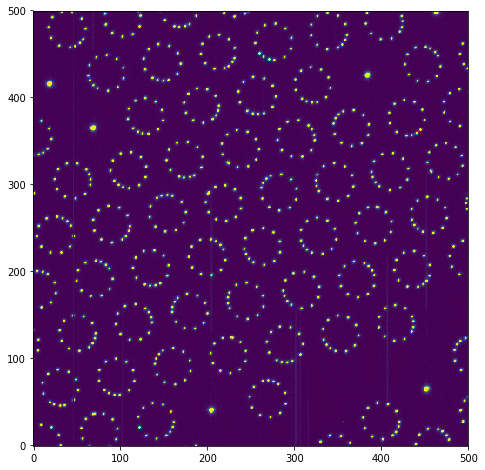

In [7]:
m = np.median(img)
figure(figsize=(8,8))
imshow(img, vmin=m-5, vmax=m+10000)

## bokeh it

In [16]:
img = np.zeros((3000, 3000))
ny, nx = img.shape
for pix in images[0:12]:
    img += pix[400:400+ny, 400:400+nx]

In [17]:
ny, nx

(3000, 3000)

In [18]:
import bokeh.plotting as bk
bk.output_notebook()

Loading BokehJS ...

In [19]:
m = np.median(img)
lo, hi = m-5, m+10000
img2 = ((2**15 - 1)*(img.clip(lo, hi)-lo)/(hi-lo)).astype(np.int16)

In [20]:
np.min(img2), np.max(img2)

(0, 32767)

In [27]:
tools = "pan,wheel_zoom,box_zoom,undo,redo,reset"
fig = bk.figure(width=900, height=900, active_drag='box_zoom', active_scroll='auto', tools=tools)
# fig.toolbar.active_drag = 'box_select'
# fig.toolbar.active_scroll = "auto"
fig.image([img2,], 400, 400, 400+nx, 400+ny)
bk.show(fig)

In [28]:
bk.save(fig, 'fvcarc-20200109-00039228.html', title='FVC arc stack')

/global/common/software/desi/cori/desiconda/20190804-1.3.0-spec/conda/lib/python3.6/site-packages/bokeh/io/saving.py:126: UserWarning: save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN
  warn("save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN")


'/global/u2/s/sjbailey/desi/dev/desicmx/analysis/fpcalib/posarc-20200108/fvcarc-20200109-00039228.html'

In [ ]:
fig.image?

In [ ]:
xx = slice(2500, 2580)
yy = slice(2520, 2600)

img = np.zeros((yy.stop-yy.start, xx.stop-xx.start))
for pix in images:
    img += pix[yy,xx]
    
m = np.median(img)
figure(figsize=(8,8))
imshow(img, vmin=m-5, vmax=m+10000)

In [ ]:
xx.stop-xx.start

## Identify the movement of a single positioner

In [ ]:
imgmeta[0].colnames

In [ ]:
x = np.array([m['x'] for m in imgmeta])
y = np.array([m['y'] for m in imgmeta])
device_id = imgmeta[0]['device_id']

In [ ]:
ii = np.where((xx.start < x) & (x < xx.stop) & (yy.start < y) & (y < yy.stop))

In [ ]:
ii

In [ ]:
x.shape, y.shape

In [ ]:
plot(x[ii], y[ii], '.')